<a href="https://colab.research.google.com/github/anou1234/Text_to_image_generation_with_Dreambooth/blob/main/gen_ai_dreambooth.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Installing the required dependencies & importing the model
importing dreambooth's runwayml/stable-diffusion-v1-5 model; we'll finetune it to generate professional attire images from regular images of women.

In [ ]:
# Install diffusers
!git clone https://github.com/ShivamShrirao/diffusers

%cd diffusers/
!pip install -e .

# For GPU efficiency
!pip install bitsandbytes

# Install dreambooth requirements
%cd /content/diffusers/examples/dreambooth/
!pip install -r requirements.txt

# Accelerate environment
!accelerate config default

Cloning into 'diffusers'...
remote: Enumerating objects: 20186, done.
remote: Counting objects: 100% (1/1), done.
remote: Total 20186 (delta 0), reused 0 (delta 0), pack-reused 20185
Receiving objects: 100% (20186/20186), 24.85 MiB | 15.60 MiB/s, done.
Resolving deltas: 100% (13418/13418), done.
/content/diffusers
Obtaining file:///content/diffusers
  Installing build dependencies ... done
  Checking if build backend supports build_editable ... done
  Getting requirements to build editable ... done
  Preparing editable metadata (pyproject.toml) ... done
  Building editable for diffusers (pyproject.toml) ... done
  Created wheel for diffusers: filename=diffusers-0.15.0.dev0-0.editable-py3-none-any.whl size=11075 sha256=87a4b80208b0defd913c31932431dbfb5972a30109fcb7617f8f15dcd62599b1
  Stored in directory: /tmp/pip-ephem-wheel-cache-a0bzu_5p/wheels/95/c5/3b/e1b4269f8a2584de57e75f949a185b48fc4144e9a91fc9965a
Successfully built diffusers
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 119.8/

## Gathering the underlying GPU information to set the fine tuning parameters accordingly

In [ ]:
!nvidia-smi

Mon May 13 13:47:31 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   33C    P8               9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

## Uploading our dataset images into the dataset directory. The images used of 15 woman introduced in the Stable Diffusion Regularization Image Dataset v-1.5 (class=woman)
 dataset

In [ ]:
%cd /content
!mkdir images

/content


#Copying the images into our "images" directory & Displaying the dataset images being used - total of 1000 images were used



In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import os
import shutil

source_dir = "/content/drive/MyDrive/woman"  # add your dataset folder here
destination_dir = "/content/images"  # Modify as needed
num_files_to_copy = 100

# Get filenames
filenames = os.listdir(source_dir)[:num_files_to_copy]

# Copy files
for filename in filenames:
    src_path = os.path.join(source_dir, filename)
    dst_path = os.path.join(destination_dir, filename)
    shutil.copy2(src_path, dst_path)


In [ ]:
%cd /content/drive/MyDrive/woman
!ls -1 *.jpg | wc -l


/content/drive/MyDrive/woman
1000


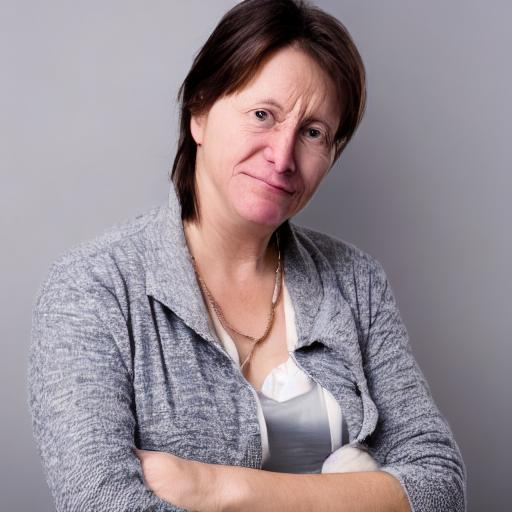

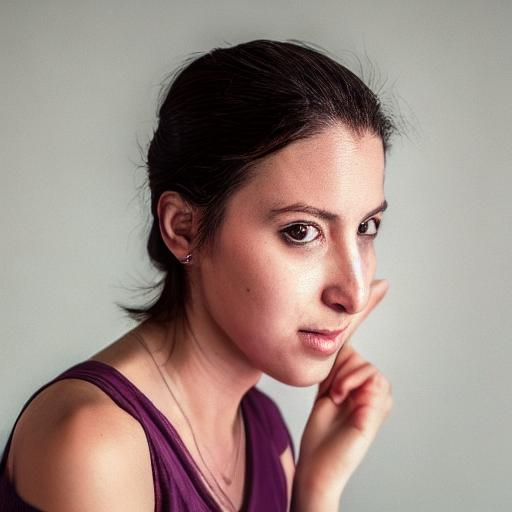

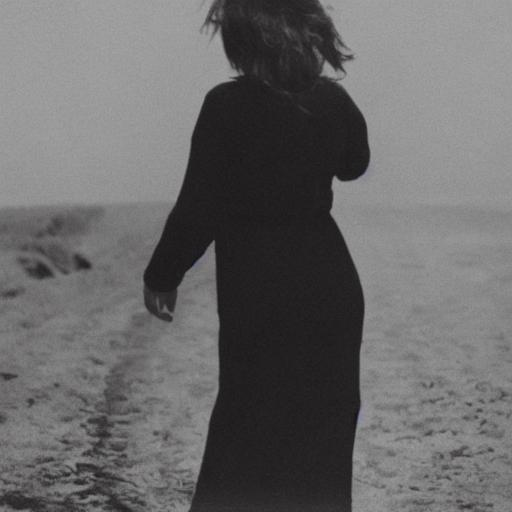

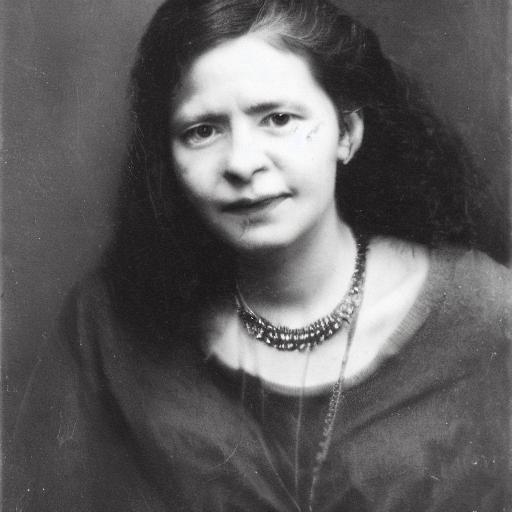

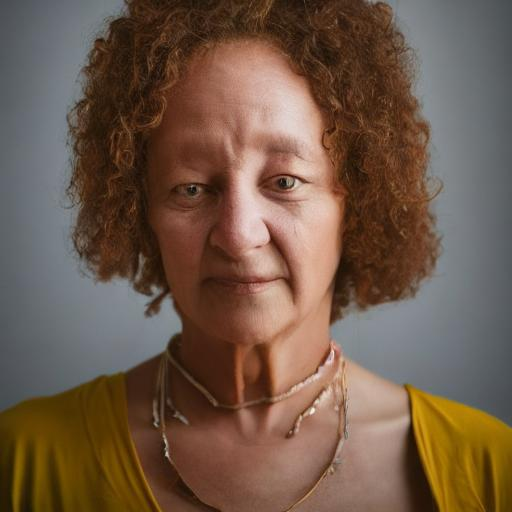

...

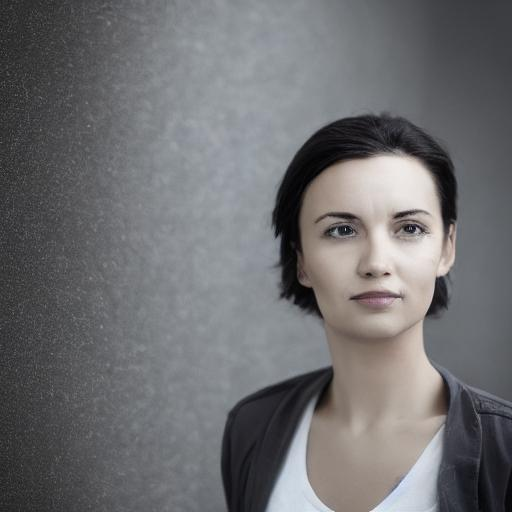

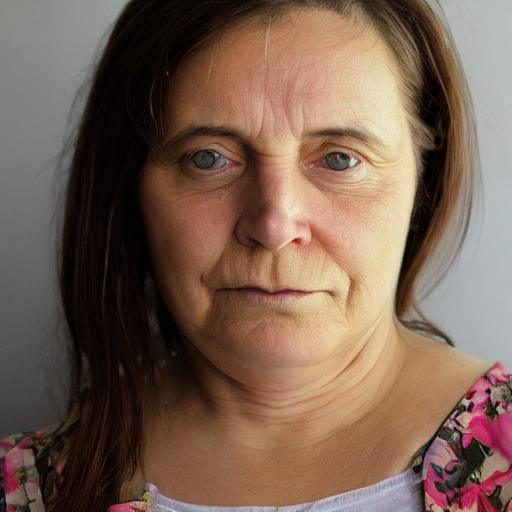

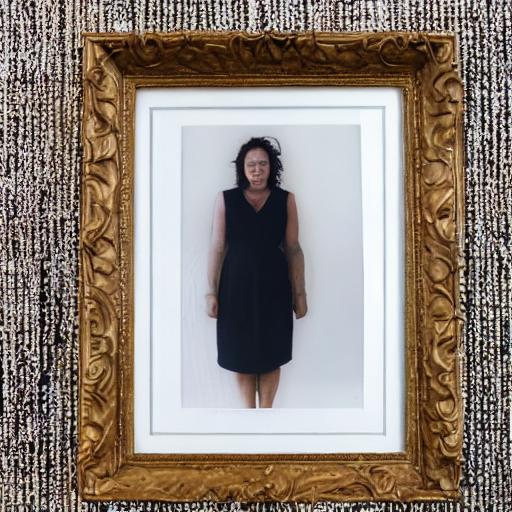

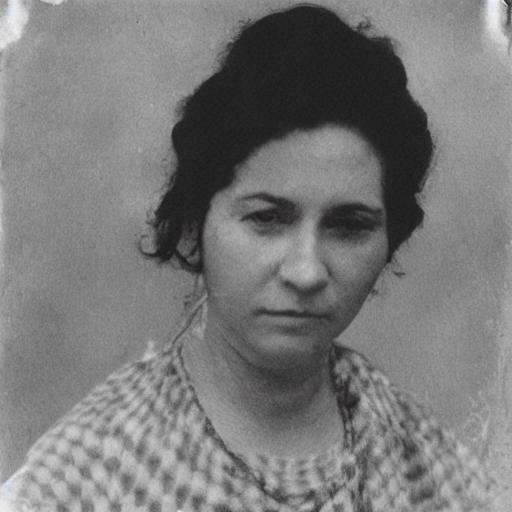

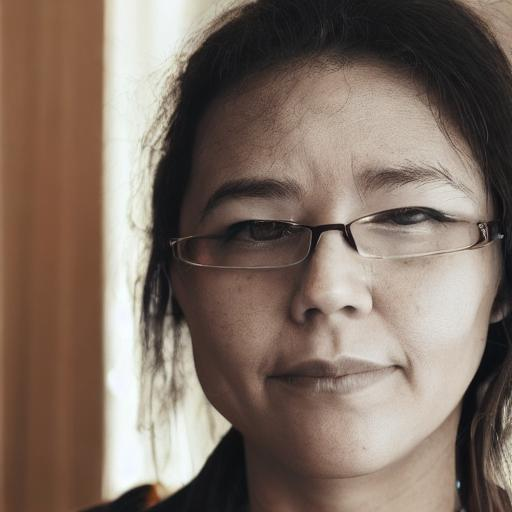

In [ ]:
import glob
from IPython.display import Image
image_paths = glob.glob("/content/images/*.jpg")[:20]

for image_path in image_paths:
    display(Image(filename=image_path))

## Fine-tuning

### Explanation of the most important args:

| Argument | Description |
| --- | --- |
| instance_data_dir | Directory of the sample images |
| instance_prompt | Prompt with the special token like [V], zwx, sks... |
| with_prior_preservation | Used to avoid overfitting and language-drift |
| num_class_images | Number of generated images (prior) |
| class_prompt | Used together with prior preservation - type of generated samples to avoid prior loss |
| use_8bit_adam | Quantized optimizer to reduce GPU memory (from bitsandbytes using reduced precision) |
| mixed_precision | Another accelerator to reduce data type precision |
| pretrained_vae_name_or_path | Custom autoencoder to improve eyes and faces |


#Setting up the training parameters and specifying the instance & output directories

In [ ]:
!pip uninstall diffusers -y
!pip install diffusers

Found existing installation: diffusers 0.15.0.dev0
Uninstalling diffusers-0.15.0.dev0:
  Successfully uninstalled diffusers-0.15.0.dev0
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 12.6 MB/s eta 0:00:00


In [ ]:
%cd /content
%env MODEL_NAME=runwayml/stable-diffusion-v1-5
%env INSTANCE_DIR=/content/images/
%env OUTPUT_DIR=outputs/
%env CLASS_DIR=/content/diffusers/examples/dreambooth/person/


!accelerate launch diffusers/examples/dreambooth/train_dreambooth.py \
    --pretrained_model_name_or_path=$MODEL_NAME  \
    --pretrained_vae_name_or_path="stabilityai/sd-vae-ft-mse" \
    --instance_data_dir=$INSTANCE_DIR \
    --output_dir=$OUTPUT_DIR \
    --class_data_dir=$CLASS_DIR \
    --with_prior_preservation --prior_loss_weight=1.0 \
    --instance_prompt="photo of zwx person" \
    --class_prompt="photo of person" \
    --resolution=512 \
    --train_batch_size=1 \
    --gradient_accumulation_steps=1 --gradient_checkpointing \
    --use_8bit_adam \
    --mixed_precision="fp16" \+
    --learning_rate=1e-6 \
    --lr_scheduler="constant" \
    --lr_warmup_steps=0 \
    --num_class_images=300 \
    --max_train_steps=1000

/content
env: MODEL_NAME=runwayml/stable-diffusion-v1-5
env: INSTANCE_DIR=/content/images/
env: OUTPUT_DIR=outputs/
env: CLASS_DIR=/content/diffusers/examples/dreambooth/person/
2024-05-13 14:58:34.280045: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-05-13 14:58:34.280108: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-05-13 14:58:34.425549: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-05-13 14:58:36.664817: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
config.json: 100% 547/547 [00:00<00:00, 2.09MB/s]
diffusion_pyt

## Generation of images now that the model is trained on our images.

In [ ]:
!pip install torchmetrics[image]


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 868.8/868.8 kB 10.3 MB/s eta 0:00:00


# Calculating the clip-score of generated images to evaluated their generation quality

In [ ]:
%cd /content
import torch
import random
from diffusers import StableDiffusionPipeline
from PIL import Image
import torchvision.transforms as transforms
from torchmetrics.functional.multimodal import clip_score
from functools import partial

# Load your custom model
model_id = "outputs/1000"
pipe = StableDiffusionPipeline.from_pretrained(model_id, torch_dtype=torch.float16).to("cuda")

# Define example prompts
example_prompts = [
    "close-up photo of a person in a suit",
    "closeup portrait of a person in a suit, highly detailed, with future city skyline in the background",
    "Professional headshot of a person inside a modern office building, highly detailed, business, open eyes",
    "LinkedIn profile picture of a person, close up, professional, businessman, blue suit, 8k"
]


# Configuration for image transformation
transform = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize image to fit CLIP input
    transforms.ToTensor(),  # Convert to PyTorch tensor
    # transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalization for CLIP

])
clip_score_fn = partial(clip_score, model_name_or_path="openai/clip-vit-base-patch16")

num_images = 50
for i in range(num_images):
    prompt = example_prompts[random.randint(0, len(example_prompts) - 1)]
    image = pipe(prompt, num_inference_steps=50, guidance_scale=7.5).images[0]
    image.save(f"profile_{i}.png")

    # Load the image, apply transformations and evaluate using CLIP-IQA
    img_pil = Image.open(f"profile_{i}.png").convert("RGB")
    img_tensor = transform(img_pil).unsqueeze(0).to('cuda')

    # Calculate the CLIP score
    clip_score_value = clip_score_fn(torch.from_numpy(img_tensor.cpu().numpy()).float(), prompt).item()
    print(f"Image {i} CLIP score: {clip_score_value}")

/content


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/50 [00:00<?, ?it/s]

Image 0 CLIP score: 25.028812408447266


  0%|          | 0/50 [00:00<?, ?it/s]

Image 1 CLIP score: 23.357646942138672


  0%|          | 0/50 [00:00<?, ?it/s]

Image 2 CLIP score: 23.283103942871094


  0%|          | 0/50 [00:00<?, ?it/s]

Image 3 CLIP score: 24.95814323425293


  0%|          | 0/50 [00:00<?, ?it/s]

Image 4 CLIP score: 22.79009246826172


  0%|          | 0/50 [00:00<?, ?it/s]

Image 5 CLIP score: 21.83340072631836


  0%|          | 0/50 [00:00<?, ?it/s]

Image 6 CLIP score: 25.090736389160156


  0%|          | 0/50 [00:00<?, ?it/s]

Image 7 CLIP score: 21.491989135742188


  0%|          | 0/50 [00:00<?, ?it/s]

Image 8 CLIP score: 23.151561737060547


  0%|          | 0/50 [00:00<?, ?it/s]

Image 9 CLIP score: 23.24767303466797


  0%|          | 0/50 [00:00<?, ?it/s]

Image 10 CLIP score: 21.727272033691406


  0%|          | 0/50 [00:00<?, ?it/s]

Image 11 CLIP score: 23.203248977661133


  0%|          | 0/50 [00:00<?, ?it/s]

Image 12 CLIP score: 21.689849853515625


  0%|          | 0/50 [00:00<?, ?it/s]

Image 13 CLIP score: 23.692611694335938


  0%|          | 0/50 [00:00<?, ?it/s]

Image 14 CLIP score: 24.95264434814453


  0%|          | 0/50 [00:00<?, ?it/s]

Image 15 CLIP score: 22.6462459564209


  0%|          | 0/50 [00:00<?, ?it/s]

Image 16 CLIP score: 21.498254776000977


  0%|          | 0/50 [00:00<?, ?it/s]

Image 17 CLIP score: 22.58118438720703


  0%|          | 0/50 [00:00<?, ?it/s]

Image 18 CLIP score: 25.134008407592773


  0%|          | 0/50 [00:00<?, ?it/s]

Image 19 CLIP score: 21.682754516601562


  0%|          | 0/50 [00:00<?, ?it/s]

Image 20 CLIP score: 24.89401626586914


  0%|          | 0/50 [00:00<?, ?it/s]

Image 21 CLIP score: 23.23781967163086


  0%|          | 0/50 [00:00<?, ?it/s]

Image 22 CLIP score: 21.67268180847168


  0%|          | 0/50 [00:00<?, ?it/s]

Image 23 CLIP score: 21.70460319519043


  0%|          | 0/50 [00:00<?, ?it/s]

Image 24 CLIP score: 23.195280075073242


  0%|          | 0/50 [00:00<?, ?it/s]

Image 25 CLIP score: 23.205684661865234


  0%|          | 0/50 [00:00<?, ?it/s]

Image 26 CLIP score: 21.99021339416504


  0%|          | 0/50 [00:00<?, ?it/s]

Image 27 CLIP score: 23.01715087890625


  0%|          | 0/50 [00:00<?, ?it/s]

Image 28 CLIP score: 22.89065170288086


  0%|          | 0/50 [00:00<?, ?it/s]

Image 29 CLIP score: 23.40235137939453


  0%|          | 0/50 [00:00<?, ?it/s]

Image 30 CLIP score: 22.866939544677734


  0%|          | 0/50 [00:00<?, ?it/s]

Image 31 CLIP score: 25.015687942504883


  0%|          | 0/50 [00:00<?, ?it/s]

Image 32 CLIP score: 22.862247467041016


  0%|          | 0/50 [00:00<?, ?it/s]

Image 33 CLIP score: 24.80677604675293


  0%|          | 0/50 [00:00<?, ?it/s]

Image 34 CLIP score: 25.12729835510254


  0%|          | 0/50 [00:00<?, ?it/s]

Image 35 CLIP score: 24.91525650024414


  0%|          | 0/50 [00:00<?, ?it/s]

Image 36 CLIP score: 21.88836097717285


  0%|          | 0/50 [00:00<?, ?it/s]

Image 37 CLIP score: 21.4482479095459


  0%|          | 0/50 [00:00<?, ?it/s]

Image 38 CLIP score: 22.878599166870117


  0%|          | 0/50 [00:00<?, ?it/s]

Image 39 CLIP score: 23.238811492919922


  0%|          | 0/50 [00:00<?, ?it/s]

Image 40 CLIP score: 23.272754669189453


  0%|          | 0/50 [00:00<?, ?it/s]

Image 41 CLIP score: 21.69953727722168


  0%|          | 0/50 [00:00<?, ?it/s]

Image 42 CLIP score: 22.870159149169922


  0%|          | 0/50 [00:00<?, ?it/s]

Image 43 CLIP score: 23.210556030273438


  0%|          | 0/50 [00:00<?, ?it/s]

Image 44 CLIP score: 25.098800659179688


  0%|          | 0/50 [00:00<?, ?it/s]

Image 45 CLIP score: 25.15946388244629


  0%|          | 0/50 [00:00<?, ?it/s]

Image 46 CLIP score: 25.082382202148438


  0%|          | 0/50 [00:00<?, ?it/s]

Image 47 CLIP score: 21.312517166137695


  0%|          | 0/50 [00:00<?, ?it/s]

Image 48 CLIP score: 21.84626007080078


  0%|          | 0/50 [00:00<?, ?it/s]

Image 49 CLIP score: 21.75035858154297


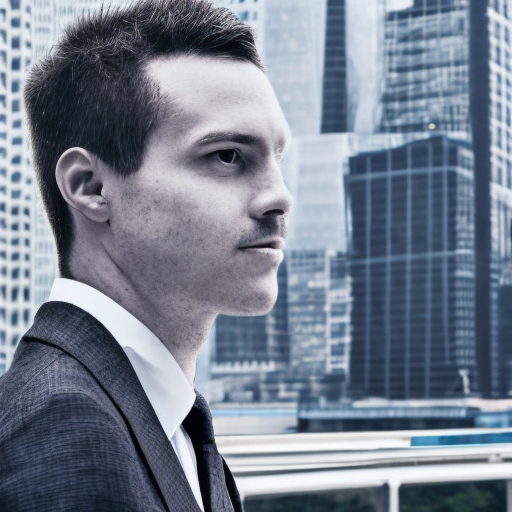

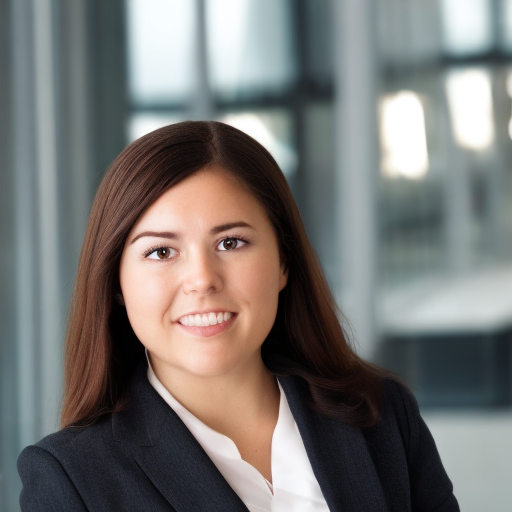

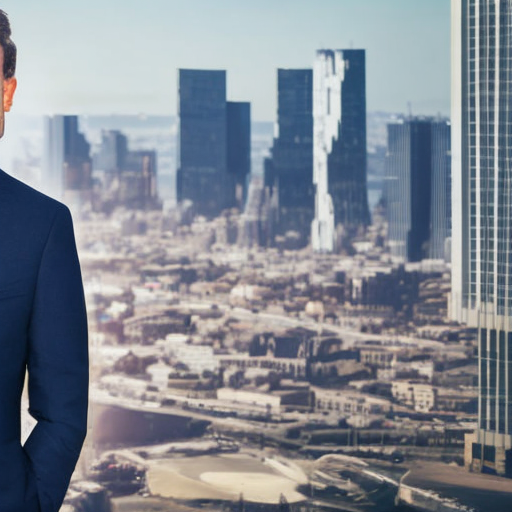

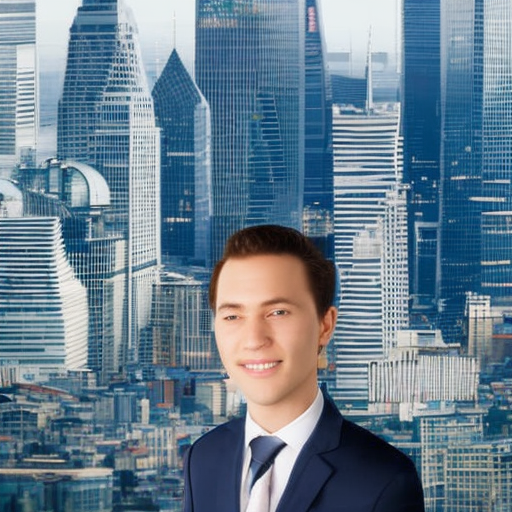

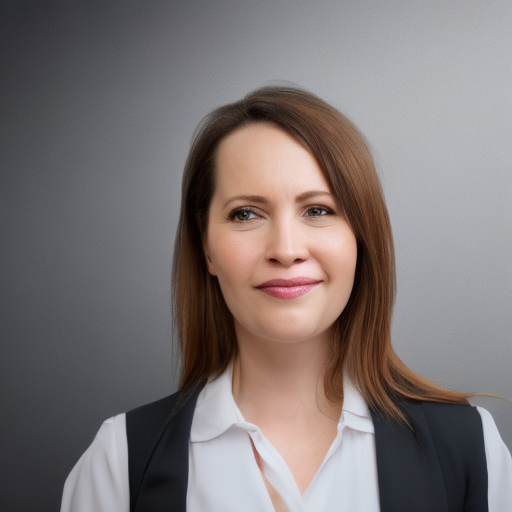

...

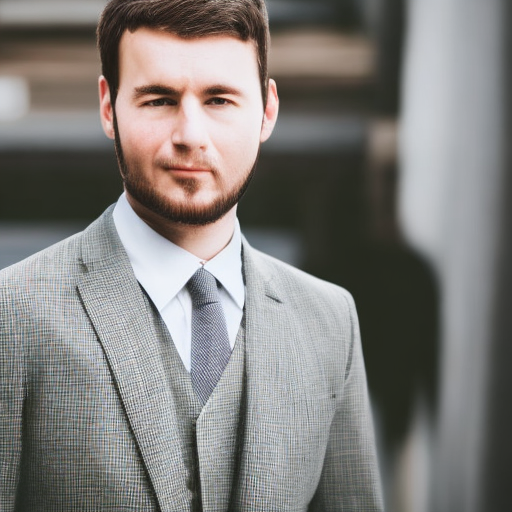

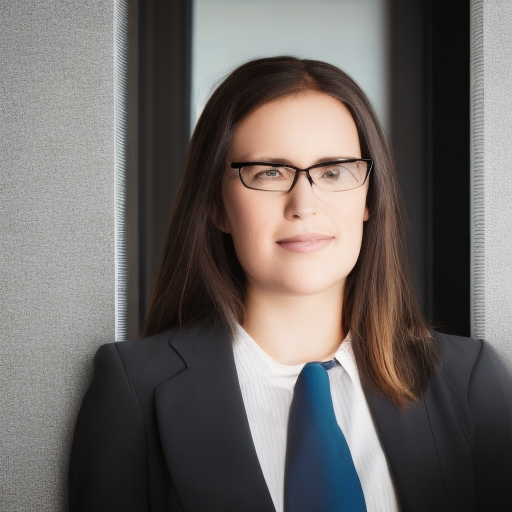

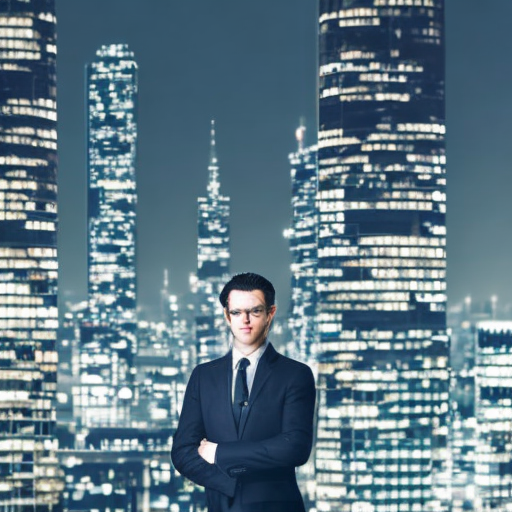

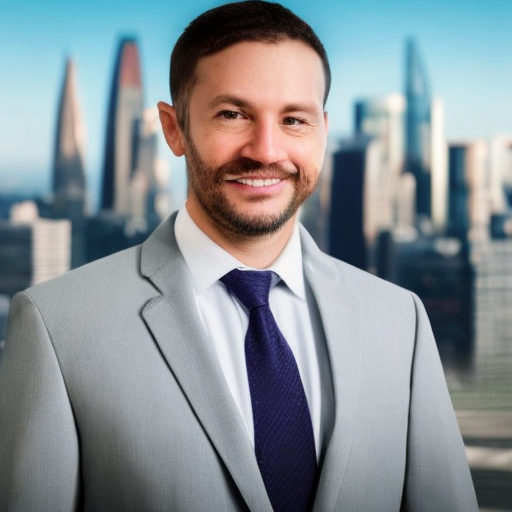

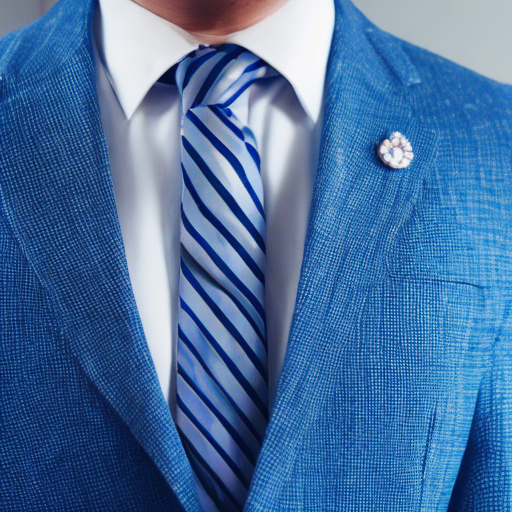

In [ ]:
from IPython.display import Image

import glob
image_paths = glob.glob("/content/*.png")

for image_path in image_paths:
    display(Image(filename=image_path))
